In [1]:
import os
import pickle
from datetime import date
import pandas as pd
import itertools
import empyrical as empy
import matplotlib.pyplot as plt

from sklearn.metrics import (
    precision_score, accuracy_score, confusion_matrix, 
    mean_squared_error, recall_score, f1_score
)

import warnings
warnings.filterwarnings("ignore")

In [27]:
def show_cum_ret(ret, title=None):
    fig, ax = plt.subplots(figsize=(24,15))
    cm = plt.get_cmap('gist_rainbow')
    if isinstance(ret, pd.Series):
        NUM_COLORS = 1
    else:
        NUM_COLORS = ret.shape[1]
    ax.set_prop_cycle(color=[cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)])

    (1+ret).cumprod().plot(ax=ax)

    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    ax.set_yscale("log")
    if title is not None:
        ax.set_title(title)
    plt.show()

In [2]:
def read_kpi2ret(result_excel_name, start=None, end=None):
    hist = pd.read_excel(result_excel_name, index_col=0, sheet_name='History')
    hist.index = pd.to_datetime(hist.index)
    balance = hist['Balance']
    balance_ = pd.concat([pd.Series(1e9),balance])
    ret = balance_.pct_change().ffill().dropna()
    ret.index = pd.to_datetime(ret.index)
    if start is not None:
        ret = ret[start:]
    if end is not None:
        ret = ret[:end]
    return ret


def cal_metric(y_true, y_pred):

    if isinstance(y_pred, pd.DataFrame):
        prec_ser = pd.Series(index=y_pred.columns, name='precision')
        acccc_ser = pd.Series(index=y_pred.columns, name='accuracy')
        recall_ser = pd.Series(index=y_pred.columns, name='recall')
        recall0_ser = pd.Series(index=y_pred.columns, name='recall0')
        f1_score_ser = pd.Series(index=y_pred.columns, name='f1_score')
        f0_score_ser = pd.Series(index=y_pred.columns, name='f0_score')
        for col in y_pred.columns:
            # print("   *********************************  ", col)
            if isinstance(y_true, pd.DataFrame):
                tmp_y_true = y_true[col]
            else:
                tmp_y_true = y_true.copy()
            prec_ser[col], acccc_ser[col], recall_ser[col], recall0_ser[col], f1_score_ser[col], f0_score_ser[col] = cal_metric(
                tmp_y_true, y_pred[col])
        return prec_ser, acccc_ser, recall_ser, recall0_ser, f1_score_ser, f0_score_ser

    y_true = y_true.reindex(y_pred.index)
    tmp = pd.concat([y_true, y_pred], axis=1).dropna()
    y_true = tmp.iloc[:, 0]
    y_pred = tmp.iloc[:, -1]
    # print("y_pred\n", y_pred)
    # print("y_true\n", y_true)
    # pd.concat([y_proba, y_pred, y_pctch, y_true, ydelta_true], axis=1).to_csv("./tmp/{}.csv".format(y_pctch.name))

    try:
        prec = precision_score(y_true=y_true, y_pred=y_pred)
        acccc = accuracy_score(y_true=y_true, y_pred=y_pred)
    except Exception as e:
        print(e)
        prec = 0
        acccc = 0

    try:
        recall = recall_score(y_true=y_true, y_pred=y_pred)
        recall0 = recall_score(y_true=y_true, y_pred=y_pred, pos_label=0)
    except Exception as e:
        print(e)
        recall = 0
        recall0 = 0

    try:
        f1score = f1_score(y_true=y_true, y_pred=y_pred)
        f0score = f1_score(y_true=y_true, y_pred=y_pred, pos_label=0)
    except Exception as e:
        print(e)
        f1score = 0
        f0score = 0
    # print("mse, mse_proba, msefullscore, msefullscore_ret, prec, acccc, recall, recall0")
    # print(mse, mse_proba, msefullscore, msefullscore_ret, prec, acccc, recall, recall0)
    return prec, acccc, recall, recall0, f1score, f0score

In [ ]:
base_no3vote = './result/2022/MPT_kpi/1.5.1b/'
mpt_v = '151b'
start = '2008'
end = '2022-07'
client_ret = {}
for result_excel_name in os.listdir(base_no3vote):
    if result_excel_name.endswith('.xlsx'):
        client = result_excel_name.replace('.xlsx', '').split('_')[-1]
        ret = read_kpi2ret(os.path.join(base_no3vote, result_excel_name), start, end)
        ret.name = client
        client_ret[client] = ret

In [ ]:
client_ret_df = pd.concat(client_ret.values(), keys=client_ret.keys(), axis=1)
client_ret_df

In [ ]:
cum_returns = empy.cum_returns(client_ret_df)
cum_returns.plot(figsize=(20, 10), title='cum_returns').legend(bbox_to_anchor=(1.1, 1.05))
client_ret_df.index = pd.to_datetime(client_ret_df.index)

for client in client_ret_df.columns:
    # ax = client_ret_df[client].plot.bar(figsize=(20, 10), title='daily return')
    # for i, t in enumerate(ax.get_xticklabels()):
    #     if (i % 252*3) != 0:
    #         t.set_visible(False)
    # ax.legend(bbox_to_anchor=(1.1, 1.05))


    fig, ax = plt.subplots(1, 1, figsize=(20, 10))
    fig.suptitle(client)

    ax.bar(client_ret_df[client].index, client_ret_df[client].values, label=client)
    ax.set_ylabel('daily return')
    ax.legend(bbox_to_anchor=(1.1, 1.05))

In [25]:
result_excel_name = './result/2022/cashON_signal/result/long_hist/config_aml1983_withlongpred_with_newp_Agg_oldconfig_newbl_68-2205.xlsx'
hist = pd.read_excel(result_excel_name, index_col=0, sheet_name='History')
hist.index = pd.to_datetime(hist.index)
balance = hist['Balance']
portfolio_ret = balance.pct_change()

In [3]:
# preds_csv = [
#     ('./data/data_price/data_price_xxz.csv', [0], ['xxz'], [1, 5, 10, 21]),
#     ('./data/data_price/data_price_xzz.csv', [0], ['xzz'], [1, 5, 10, 21]),
#     ('./data/data_price/data_price(13ETFs).csv', None, None, [1, 5, 10, 21])
# ]

preds_csv = [
    # ('./data/data_price/data_price_xxz.csv', [0], ['xxz'], [1]),
    # ('./data/data_price/data_price_xzz.csv', [0], ['xzz'], [1]),
    # ('./data/data_price/data_price(13ETFs).csv', None, None, [1])
    ('./result/2022/cashON_signal/result/long_hist/backtest_AML_ETF_2000_202205.csv', None, None, [1])  # long history
]



preds = pd.DataFrame()
rets = pd.DataFrame()
for f, col, col_name, pps in preds_csv:
    print(f, col, col_name, pps)
    df = pd.read_csv(f, index_col=0)
    df.index = pd.to_datetime(df.index)
    if col is not None:
        df = df.iloc[:, col]
        df.columns = col_name

    if 'code' in df.columns:
        df = pd.pivot_table(df, values='close', columns='code', index='date')


    for pp in pps:
        df_pct = df.pct_change(pp)
        df_pct.columns = ["{}_pp{}".format(c, pp) for c in df_pct.columns]
        rets = pd.concat([rets, df_pct], axis=1)
        df_pct = (df_pct>=0).astype(int)
        preds = pd.concat([preds, df_pct], axis=1)

preds = preds.dropna()
rets = rets.dropna(how='all')
display(rets.columns)
rets

./result/2022/cashON_signal/result/long_hist/backtest_AML_ETF_2000_202205.csv None None [1]


Index(['AML_BCIU1T_INDEX_pp1', 'AML_CORN_pp1', 'AML_EEM_pp1', 'AML_EMB_pp1',
       'AML_EWC_pp1', 'AML_EWG_pp1', 'AML_EWH_pp1', 'AML_EWJ_pp1',
       'AML_EWP_pp1', 'AML_EWQ_pp1', 'AML_EWU_pp1', 'AML_GLD_pp1',
       'AML_HG1_COMDTY_pp1', 'AML_IEF_pp1', 'AML_JB1_COMDTY_pp1',
       'AML_LA1_COMDTY_pp1', 'AML_LC1_COMDTY_pp1', 'AML_LQD_pp1',
       'AML_SB1_COMDTY_pp1', 'AML_SHY_pp1', 'AML_SOYB_pp1', 'AML_SPY_pp1',
       'AML_TIP_pp1', 'AML_TLT_pp1', 'AML_UNG_pp1', 'AML_USO_pp1',
       'AML_VGK_pp1', 'AML_WEAT_pp1', 'AML_WIP_pp1', 'AML_XM1_COMDTY_pp1'],
      dtype='object')

,AML_BCIU1T_INDEX_pp1,AML_CORN_pp1,AML_EEM_pp1,AML_EMB_pp1,AML_EWC_pp1,AML_EWG_pp1,AML_EWH_pp1,AML_EWJ_pp1,AML_EWP_pp1,AML_EWQ_pp1,...,AML_SOYB_pp1,AML_SPY_pp1,AML_TIP_pp1,AML_TLT_pp1,AML_UNG_pp1,AML_USO_pp1,AML_VGK_pp1,AML_WEAT_pp1,AML_WIP_pp1,AML_XM1_COMDTY_pp1
date,,,,,,,,,,,,,,,,,,,,,
1962-01-04,NaN,-0.001139,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,...,-0.005105,-0.006889,0.005084,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-05,NaN,-0.002281,NaN,NaN,NaN,-0.018519,NaN,-0.015788,NaN,NaN,...,0.001026,-0.013873,0.004795,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-08,NaN,-0.002286,NaN,NaN,NaN,-0.017002,NaN,0.003409,NaN,NaN,...,0.000000,-0.007752,-0.008295,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-09,NaN,0.003436,NaN,NaN,NaN,-0.000844,NaN,0.004996,NaN,NaN,...,-0.002050,0.000434,0.001939,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1962-01-10,NaN,-0.004566,NaN,NaN,NaN,0.017099,NaN,0.004573,NaN,NaN,...,-0.002054,-0.002748,-0.003057,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-05-23,-0.013431,0.008975,0.007535,0.000669,0.017399,0.022997,0.000000,0.009634,0.024439,0.022950,...,-0.005278,0.018710,-0.003541,-0.016454,0.084385,0.003919,0.021295,0.034783,0.003261,-0.000155
2022-05-24,0.008046,-0.017106,-0.017370,0.008697,-0.010043,-0.006744,-0.012856,-0.003817,0.013297,-0.003290,...,-0.002122,-0.007634,0.005415,0.019732,0.001663,0.000366,-0.000171,-0.031933,-0.002031,0.000103
2022-05-25,0.008112,-0.006613,0.004910,0.008843,0.004936,-0.000754,0.001395,0.002090,0.007333,-0.000600,...,-0.001772,0.008835,0.000842,0.003954,0.013612,0.005854,-0.000855,-0.009549,0.002035,0.000828


In [ ]:
# assets = ['DBC', 'EEM', 'IYR', 'TLT', 'VTI', 'SPY', 'QQQ', 'VGK', 'EWJ', 'GLD', 'LQD', 'VYM', 'TIP'] # v1
# corr_assets = ['DBC', 'EEM', 'TLT', 'IYR', 'TIP'] # v2
# corr_assets = ['DBC', 'EEM', 'TLT', 'GLD', 'LQD'] # v3
# corr_assets = ['DBC', 'EEM', 'TLT', 'GLD'] # v4
# corr_assets = ['DBC', 'EEM', 'TLT', 'IYR'] # v5
# corr_assets = ['EEM', 'TLT', 'GLD'] # v6

In [4]:
# long history
corr_assets = [
    'AML_EWU', 'AML_EWC', 'AML_EWG', 'AML_EWH', 'AML_EWJ', 'AML_TIP', 
    'AML_SPY', 'AML_CORN', 'AML_GLD', 'AML_WEAT', 'AML_LC1_COMDTY', 
    'AML_SOYB', 'AML_SB1_COMDTY', 'AML_LQD', 'AML_TLT', 'AML_IEF'
]  # v1

# corr_assets = ['AML_EWH', 'AML_SB1_COMDTY', 'AML_LQD', 'AML_TLT'] # v2
# corr_assets = ['AML_EWH', 'AML_SB1_COMDTY', 'AML_TIP', 'AML_EWU'] # v3

# corr_assets = ['AML_TIP', 'AML_GLD', 'AML_EWU', 'AML_EWG'] # v2.2
# corr_assets = ['AML_EWH', 'AML_GLD', 'AML_LQD', 'AML_IEF'] # v3.2


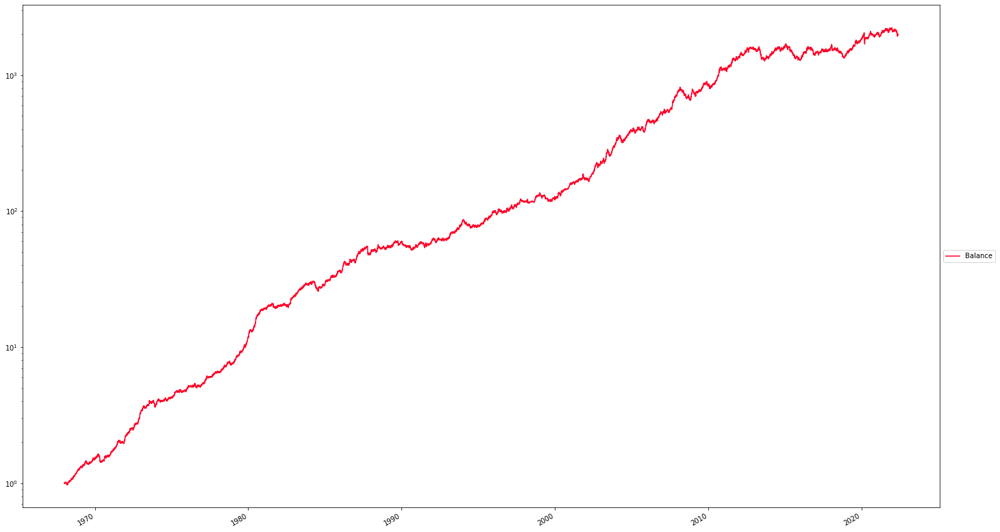

In [28]:
show_cum_ret(portfolio_ret)

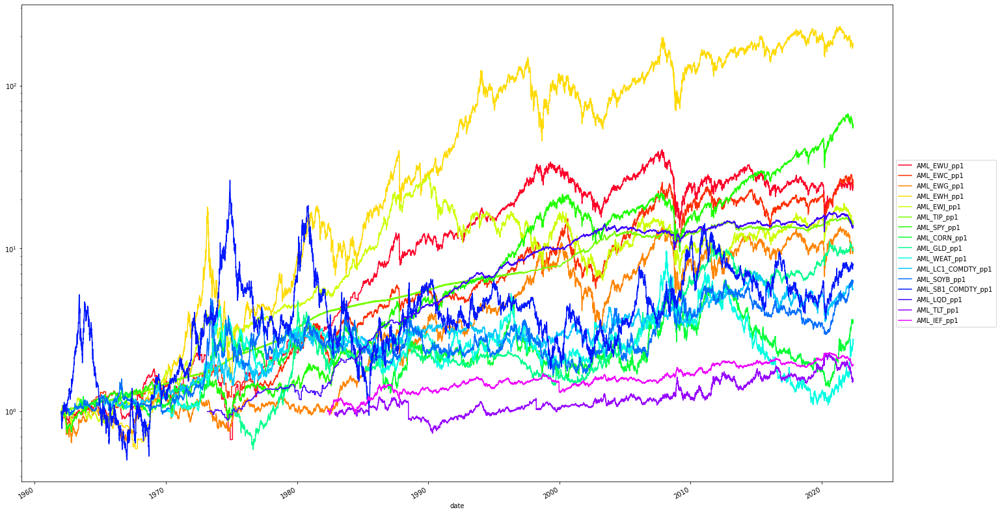

,AML_EWU_pp1,AML_EWC_pp1,AML_EWG_pp1,AML_EWH_pp1,AML_EWJ_pp1,AML_TIP_pp1,AML_SPY_pp1,AML_CORN_pp1,AML_GLD_pp1,AML_WEAT_pp1,AML_LC1_COMDTY_pp1,AML_SOYB_pp1,AML_SB1_COMDTY_pp1,AML_LQD_pp1,AML_TLT_pp1,AML_IEF_pp1
date,,,,,,,,,,,,,,,,
1962-01-04,NaN,NaN,0.000000,NaN,NaN,0.005084,-0.006889,-0.001139,NaN,NaN,NaN,-0.005105,0.000000,NaN,NaN,NaN
1962-01-05,NaN,NaN,-0.018519,NaN,-0.015788,0.004795,-0.013873,-0.002281,NaN,NaN,NaN,0.001026,-0.008065,NaN,NaN,NaN
1962-01-08,NaN,NaN,-0.017002,NaN,0.003409,-0.008295,-0.007752,-0.002286,NaN,NaN,NaN,0.000000,-0.004065,NaN,NaN,NaN
1962-01-09,NaN,NaN,-0.000844,NaN,0.004996,0.001939,0.000434,0.003436,NaN,NaN,NaN,-0.002050,-0.008163,NaN,NaN,NaN
1962-01-10,NaN,NaN,0.017099,NaN,0.004573,-0.003057,-0.002748,-0.004566,NaN,NaN,NaN,-0.002054,-0.032922,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-05-23,0.019638,0.017399,0.022997,0.000000,0.009634,-0.003541,0.018710,0.008975,0.004650,0.034783,0.009120,-0.005278,-0.009023,-0.003558,-0.016454,-0.006067
2022-05-24,0.001834,-0.010043,-0.006744,-0.012856,-0.003817,0.005415,-0.007634,-0.017106,0.007522,-0.031933,-0.000376,-0.002122,-0.001012,0.013123,0.019732,0.008623
2022-05-25,0.005188,0.004936,-0.000754,0.001395,0.002090,0.000842,0.008835,-0.006613,-0.006030,-0.009549,-0.003202,-0.001772,-0.003544,0.010309,0.003954,0.002017


In [7]:
# asset_daily_ret = rets.loc[:, (rets.columns.str.endswith('_pp1')) & ~((rets.columns.str.startswith('xxz_')) | (rets.columns.str.startswith('xzz_')))]
ll = ["{}_pp1".format(a) if not a.endswith('_pp1') else a for a in corr_assets ]
asset_daily_ret = rets[ll]
show_cum_ret(asset_daily_ret)
asset_daily_ret


In [112]:
for a in asset_daily_ret.columns:
    tmp = asset_daily_ret[a].dropna()
    print(a, tmp.index[0], tmp.index[-1])
    # tmp.plot()
    # plt.show()

AML_TIP_pp1 1962-01-04 00:00:00 2022-05-27 00:00:00
AML_GLD_pp1 1975-01-06 00:00:00 2022-05-27 00:00:00
AML_EWU_pp1 1962-04-17 00:00:00 2022-05-27 00:00:00
AML_EWG_pp1 1962-01-04 00:00:00 2022-05-27 00:00:00


In [21]:
lookback = [10, 15, 20, 50]

vol_dict = {}
vol_avg = pd.DataFrame()
vol_std = pd.DataFrame()
for lb in lookback:
    asset_vol = asset_daily_ret.rolling(lb).apply(empy.annual_volatility)#.dropna(how='all').dropna(how='all', axis=1)
    vol_dict[lb] = asset_vol
    vol_avg[lb] = asset_vol.groupby(level=0).apply(lambda x: x.dropna(how='all').dropna(how='all', axis=1).values.mean())

    vol_std[lb] = asset_vol.groupby(level=0).apply(lambda x: x.dropna(how='all').dropna(how='all', axis=1).values.std())



In [23]:
# 
vol_map = {
    'vol_dict': vol_dict,
    'vol_avg': vol_avg,
    'vol_std': vol_std,

    'vol_avg_pct': vol_avg.pct_change().dropna(),
    'vol_std_pct': vol_std.pct_change().dropna(),
}

In [8]:
## sliding correlation 13 assets
lookback = [10, 15, 20, 50] 

corr_dict = {}
corr_avg = pd.DataFrame()
corr_avg_abs = pd.DataFrame()
corr_std = pd.DataFrame()
corr_std_abs = pd.DataFrame()
for lb in lookback:
    asset_daily_corr = asset_daily_ret.rolling(lb).corr()#.dropna(how='all').dropna(how='all', axis=1)
    corr_dict[lb] = asset_daily_corr
    # display(asset_daily_corr)

    asset_daily_corr_avg = asset_daily_corr.groupby(level=0).apply(lambda x: x.dropna(how='all').dropna(how='all', axis=1).values.mean())
    # display(asset_daily_corr_avg)
    corr_avg[lb] = asset_daily_corr_avg

    asset_daily_corr_avg_abs = asset_daily_corr.groupby(level=0).apply(lambda x: x.dropna(how='all').dropna(how='all', axis=1).abs().values.mean())
    # display(asset_daily_corr_avg_abs)
    corr_avg_abs[lb] = asset_daily_corr_avg_abs

    asset_daily_corr_std = asset_daily_corr.groupby(level=0).apply(lambda x: x.dropna(how='all').dropna(how='all', axis=1).values.std())
    # display(asset_daily_corr_std)
    corr_std[lb] = asset_daily_corr_std

    asset_daily_corr_std_abs = asset_daily_corr.groupby(level=0).apply(lambda x: x.dropna(how='all').dropna(how='all', axis=1).abs().values.std())
    # display(asset_daily_corr_std_abs)
    corr_std_abs[lb] = asset_daily_corr_std_abs


In [9]:
# 
corr_map = {
    'corr_dict': corr_dict,
    'corr_avg': corr_avg,
    'corr_avg_abs': corr_avg_abs,
    'corr_std': corr_std,
    'corr_std_abs': corr_std_abs, 

    'corr_avg_pct': corr_avg.pct_change().dropna(),
    'corr_avg_abs_pct': corr_avg_abs.pct_change().dropna(),
    'corr_std_pct': corr_std.pct_change().dropna(),
    'corr_std_abs_pct': corr_std_abs.pct_change().dropna()
}

In [11]:
save_corr = './result/2022/cashON_signal/result/long_hist/corr_map_v1.obj'
if os.path.exists(save_corr):
    with open(save_corr, 'rb') as file:
        corr_map = pickle.load(file)
else:
    with open(save_corr, 'wb') as file:
        pickle.dump(corr_map, file)

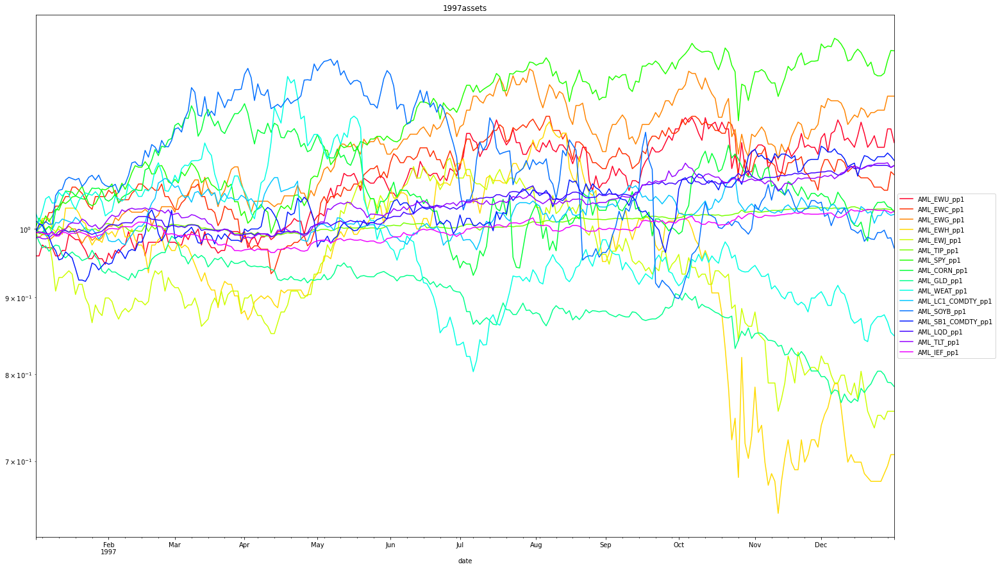

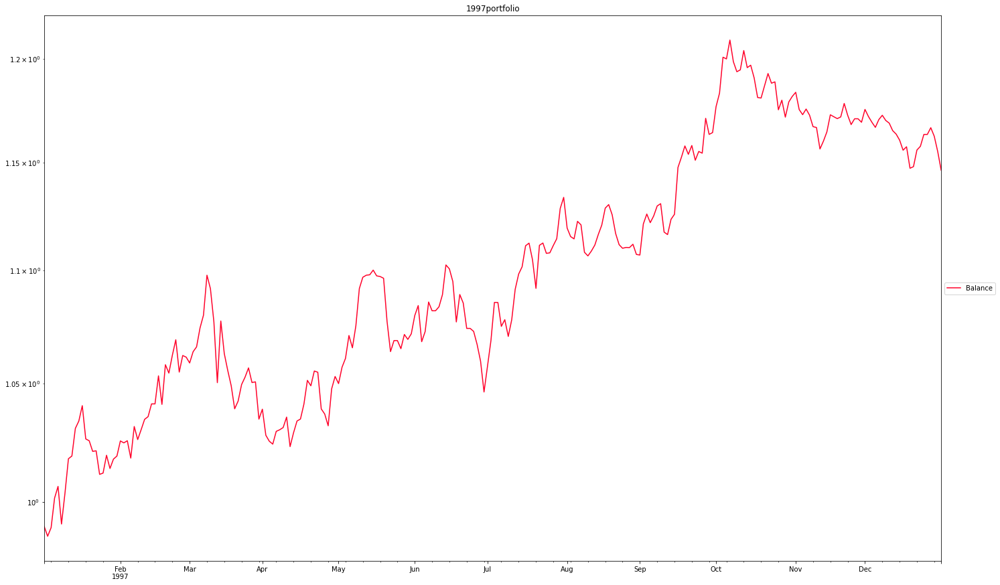

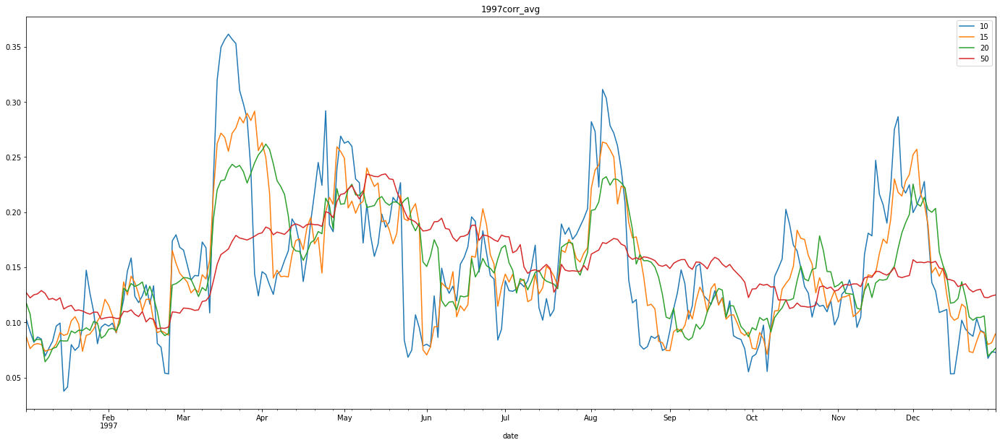

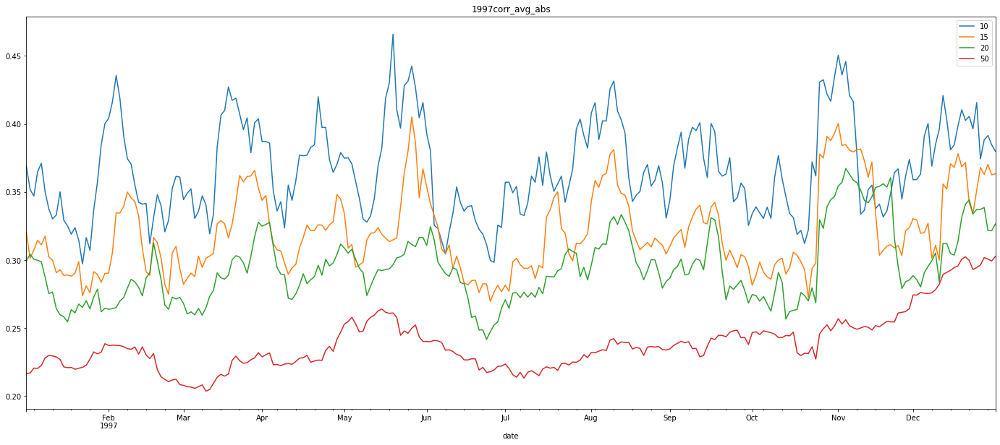

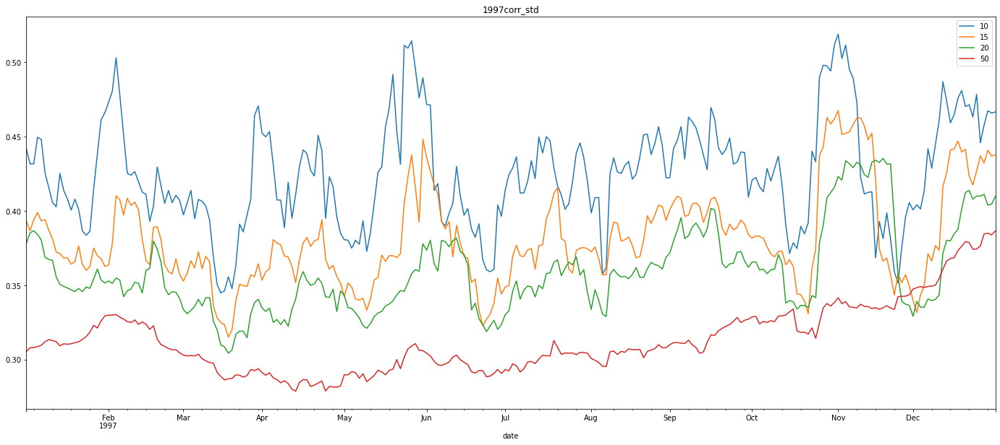

...

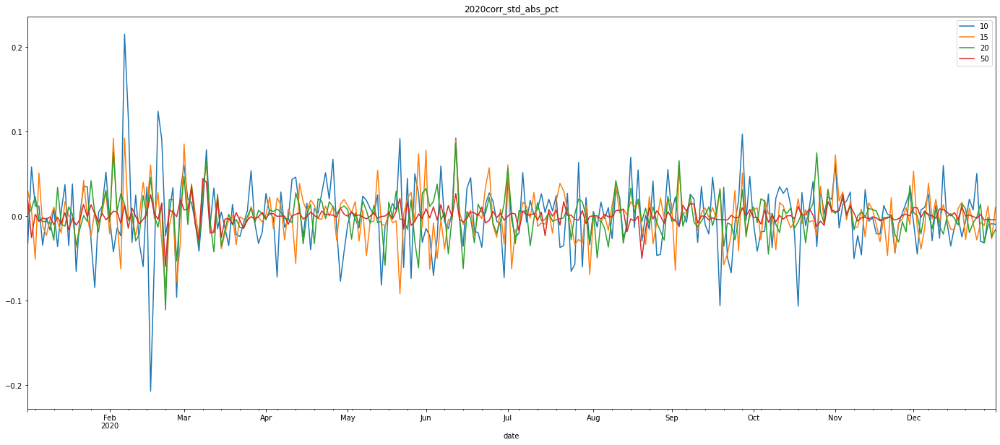

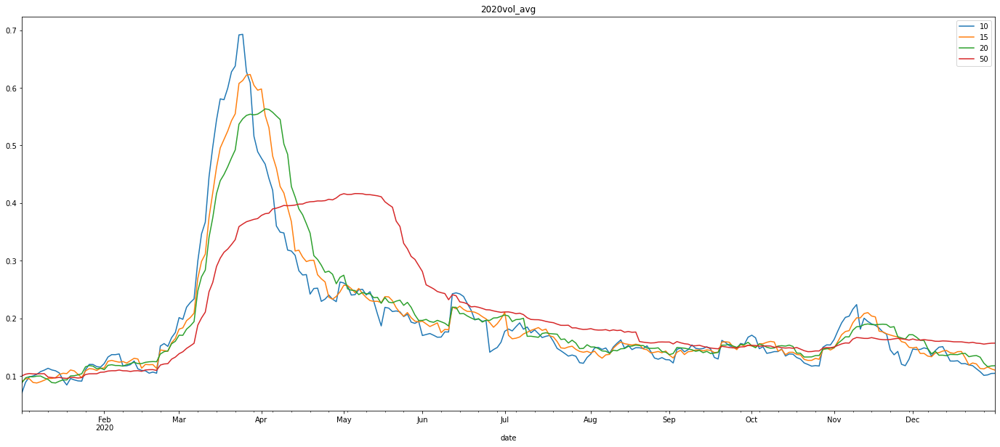

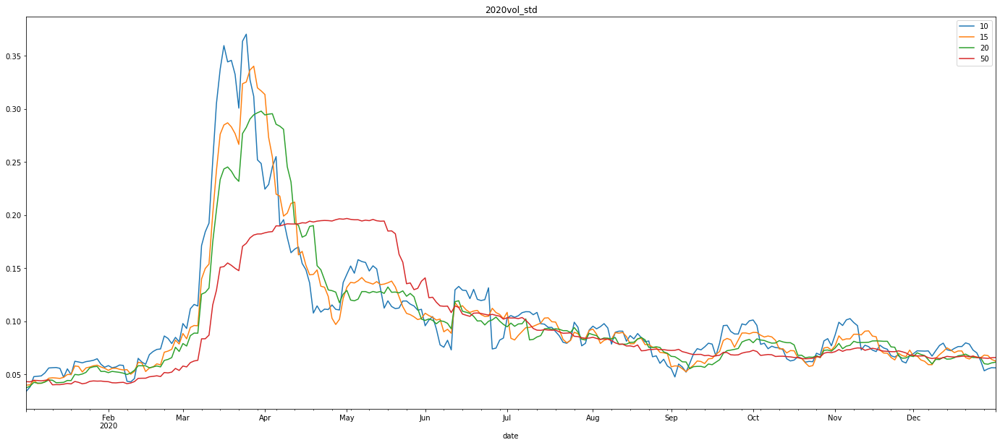

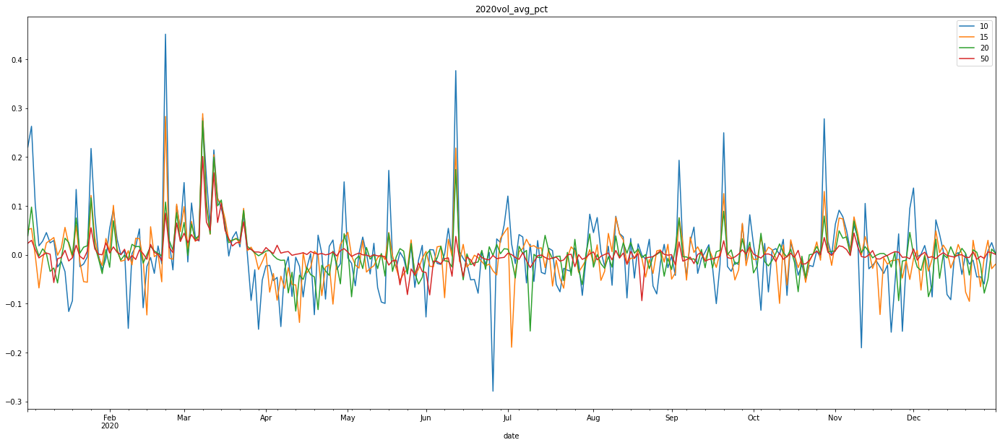

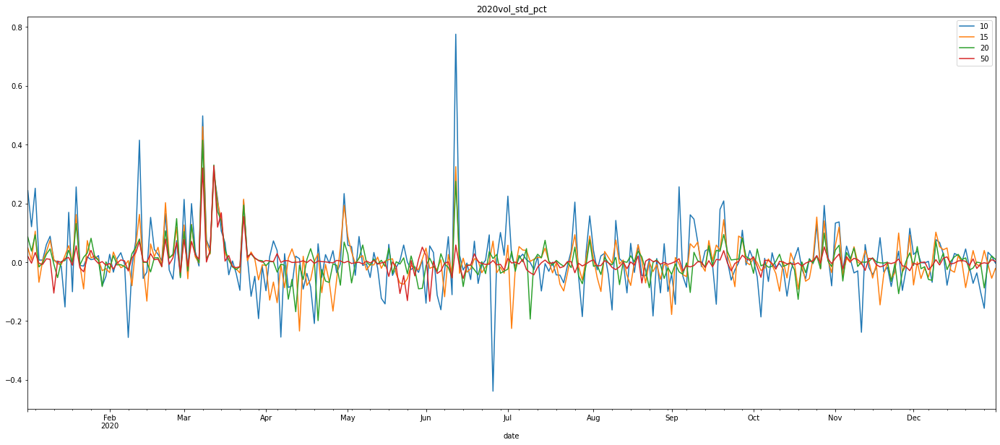

In [31]:
risk_off_period = ['1997', '1998', '2000', '2002', '2007', '2008', '2010', '2011', '2020']

for riskOFF in risk_off_period:
    show_cum_ret(asset_daily_ret[riskOFF], riskOFF+'assets')
    show_cum_ret(portfolio_ret[riskOFF], riskOFF+'portfolio')
    for metrics, corr_df in corr_map.items():
        if metrics == 'corr_dict':
            continue
        corr_df.index = pd.to_datetime(corr_df.index)
        corr_df[riskOFF].plot(figsize=(24,10), title=riskOFF + metrics)
    
    for metrics, vol_df in vol_map.items():
        if metrics == 'vol_dict':
            continue
        vol_df.index = pd.to_datetime(vol_df.index)
        vol_df[riskOFF].plot(figsize=(24,10), title=riskOFF + metrics)

        # break
    # break

In [115]:
def get_threshold(df, name):
    display(df.index[0], df.index[-1])
    tt = '{} histogram'.format(name)
    try:
        df.hist(grid=True, bins=20, rwidth=0.9, figsize=(20, 10), density = True)
        plt.suptitle(tt)
    except:
        pass

    dens_df = df.quantile([0.1, 0.2, 0.5, 0.8, 0.9]).round(2)
    display(tt, dens_df)
    gt = {}
    lt = {}
    for lb in dens_df.columns:
        base = dens_df.loc[0.5, lb]
        gt[lb] = []
        for den in [0.8, 0.9]:
            if dens_df.loc[den, lb] != base:
                gt[lb].append(dens_df.loc[den, lb])
        gt[lb] = list(set(gt[lb]))

        lt[lb] = []
        for den in [0.1, 0.2]:
            if dens_df.loc[den, lb] != base:
                lt[lb].append(dens_df.loc[den, lb])
        lt[lb] = list(set(lt[lb]))
    return gt, lt


In [ ]:
start = '1962'
end = '1987'

threshold_gt = {}
threshold_lt = {}
# for lb in lookback:
if True:
    ## histogram
    name = 'corr_avg'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)
    
    name = 'corr_avg_abs'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)

    name = 'corr_std'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)

    name = 'corr_std_abs'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)

    ## pct

    name = 'corr_avg_pct'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)
    
    name = 'corr_avg_abs_pct'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)

    name = 'corr_std_pct'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)

    name = 'corr_std_abs_pct'
    threshold_gt[name], threshold_lt[name] = get_threshold(corr_map[name][start:end], name)


In [ ]:
threshold_gt

In [ ]:
threshold_lt

In [121]:
# threshold_gt = {
#     'corr_avg': {10: [0.6, 0.5], 15: [0.5, 0.55], 20: [0.45, 0.5], 50: [0.5, 0.4]},
#     'corr_avg_abs': {10: [0.8], 15: [0.8], 20: [0.75, 0.7], 50: [0.65, 0.7]},
#     'corr_std': {10: [0.8], 15: [0.7, 0.8], 20: [0.7, 0.8], 50: [0.65, 0.7]},
#     'corr_std_abs': {10: [0.4], 15: [0.4], 20: [0.4], 50: [0.375]},

#     'corr_avg_pct': {10: [0.5, 1], 15: [0.25, 0.5], 20: [0.1, 0.2], 50: [0.05, 0.1]},
#     'corr_avg_abs_pct': {10: [0.1, 0.2], 15: [0.1, 0.2], 20: [0.2, 0.1], 50: [0.05, 0.1]},
#     'corr_std_pct': {10: [0.2, 0.4], 15: [0.1, 0.2], 20: [0.1, 0.2], 50: [0.05, 0.1]},
#     'corr_std_abs_pct': {10: [0.25, 0.5], 15: [0.1, 0.2], 20: [0.1, 0.2], 50: [0.1, 0.05]},
# }


# threshold_lt = {
#     'corr_avg': {10: [0.1], 15: [0.15], 20: [0.2], 50: [0.2]},
#     'corr_avg_abs': {10: [0.4], 15: [0.4], 20: [0.4], 50: [0.375]},
#     'corr_std': {10: [0.2, 0.3], 15: [0.35, 0.3], 20: [0.3], 50: [0.35]},
#     'corr_std_abs': {10: [0.2, 0.15], 15: [0.2, 0.15], 20: [0.2, 0.15], 50: [0.2, 0.25]},

#     'corr_avg_pct': {10: [-0.25], 15: [-0.25], 20: [-0.1], 50: [-0.05]},
#     'corr_avg_abs_pct': {10: [-0.1], 15: [-0.1], 20: [-0.1], 50: [-0.05]},
#     'corr_std_pct': {10: [-0.2], 15: [-0.1], 20: [-0.1], 50: [-0.05]},
#     'corr_std_abs_pct': {10: [-0.25], 15: [-0.1], 20: [-0.1], 50: [-0.05]},
# }

In [122]:
vote_cases = pd.DataFrame()

for metrics in threshold_gt.keys():
    # display(metrics)
    metrics_gt = threshold_gt[metrics]
    metrics_lt = threshold_lt[metrics]

    metrics_df = corr_map[metrics]

    for lb in lookback:
        lb_corr = metrics_df[lb]
        # display(lb_corr.tail(10))
        gt = metrics_gt[lb]
        # display("gt", gt)
        for g in gt:
            name = "{}__lb{}__>{}".format(metrics, lb, g)
            vote_cases[name] = (lb_corr<=g).astype(int)

        lt = metrics_lt[lb]
        # display("lt", lt)
        for l in lt:
            name = "{}__lb{}__<{}".format(metrics, lb, l)
            vote_cases[name] = (lb_corr>=l).astype(int)
        
        bt = list(itertools.product(lt, gt))
        # display("bt", bt)
        for bb in bt:
            if bb[0] == bb[1]:
                continue
            name = "{}__lb{}__out-of{}&{}".format(metrics, lb, min(bb), max(bb))
            vote_cases[name] = ((lb_corr>=min(bb))&(lb_corr<=max(bb))).astype(int)

        # display(vote_cases.tail(10))
# vote_cases

In [ ]:
vote_cases.dropna()

In [ ]:
file = './result/2022/cashON_signal/result/long_hist/corr_threshold_longhist_v2/corr_threshold_longhist_v2.2.csv'
try:
    vote_cases.to_csv(file)
    vote_cases_original = vote_cases.copy()
except:
    vote_cases_original = pd.read_csv(file, index_col=0)
    vote_cases_original.index = pd.to_datetime(vote_cases_original.index)
vote_cases_original

In [ ]:
vote_cases_original = vote_cases_original[vote_cases_original[start:].sum()[(vote_cases_original[start:].sum()/vote_cases_original[start:].count())!=1].index]
vote_cases_original

In [ ]:
pairs = list(itertools.combinations(vote_cases_original.columns, 2))
len(pairs)

In [127]:
vote_cases = pd.DataFrame()
exists_case = []
for a, b in pairs:
    # print(a, b)
    if a == b:
        continue

    if (a, b) in exists_case or (b, a) in exists_case:
        continue

    tmp = vote_cases_original[[a, b]].astype(bool)
    # display(tmp)

    name = "({})&({})".format(a, b)
    vote_cases[name] = tmp[a] & tmp[b]

    name = "({})|({})".format(a, b)
    vote_cases[name] = tmp[a] | tmp[b]

    exists_case += [(a, b), (b, a)]
    # display(vote_cases)

    # display(exists_case)

    # if len(vote_cases.columns) >= 4:
    #     break
vote_cases = vote_cases.astype(int)

In [ ]:
display(len(vote_cases))
vote_cases

In [ ]:
vote_cases = vote_cases[vote_cases[start:].sum()[(vote_cases[start:].sum()/vote_cases[start:].count())!=1].index]
vote_cases

In [130]:
vote_cases.to_csv('./result/2022/cashON_signal/result/long_hist/corr_threshold_longhist_v2/corr_threshold_longhist_v2.2-combine2condition.csv')

In [ ]:
file_list = [
    './result/2022/cashON_signal/result/long_hist/corr_threshold_longhist_v1/corr_threshold_longhist_v1.csv',
    './result/2022/cashON_signal/result/long_hist/corr_threshold_longhist_v2/corr_threshold_longhist_v2.csv',
    './result/2022/cashON_signal/result/long_hist/corr_threshold_longhist_v3/corr_threshold_longhist_v3.csv',
]

for f in file_list:
    vote_cases = pd.read_csv(f, index_col=0)
    vote_cases.index = pd.to_datetime(vote_cases.index)
    print(vote_cases.shape)
    vote_cases = vote_cases.loc[:, vote_cases.isnull().values.any(axis=0)]
    print(vote_cases.shape)
    # display(vote_cases)
    display(vote_cases.dropna())


In [ ]:
vote_down_buy_ratio_list = [0, 0.1, 0.2, 0.3]
vote_down_buy_ratio_df_list = []

for vote_down_buy_ratio in vote_down_buy_ratio_list:
    v = vote_cases.applymap(lambda x: vote_down_buy_ratio if x<0.5 else 1)
    v.columns = v.columns.map(lambda x: x+'___vote_down_buy_{}'.format(vote_down_buy_ratio))
    vote_down_buy_ratio_df_list.append(v)

vote_down_buy_ratio_df = pd.concat(vote_down_buy_ratio_df_list, 1)
vote_down_buy_ratio_df


In [ ]:
vote_down_buy_ratio_df.columns

In [ ]:
vote_down_buy_ratio_csv = './result/2022/cashON_signal/vote_down_buy_ratio_corr_threshold_v1-combine2condition.csv'
vote_down_buy_ratio_df.to_csv(vote_down_buy_ratio_csv)